In [1]:
import xarray as xr
import dask
import os
import plotly.graph_objs as go
from plotly.subplots import make_subplots

In [12]:
#datapath = "/mnt/toparctic-ns9869k-ns9252k-blomchannel/BLOM_channel_new31/"
datapath = "/mnt/toparctic-ns9869k-ns9252k-blomchannel/BLOM_channel_new05_mix1/"

In [13]:
os.listdir(datapath)

['BLOM_channel_new05_mix1_hd_2034.07.nc',
 'BLOM_channel_new05_mix1_hd_2022.04.nc',
 'BLOM_channel_new05_mix1_hd_2026.12.nc',
 'BLOM_channel_new05_mix1_hd_2027.10.nc',
 'BLOM_channel_new05_mix1_hd_2029.06.nc',
 'BLOM_channel_new05_mix1_hm_2032.07.nc',
 'BLOM_channel_new05_mix1_hd_2024.10.nc',
 'BLOM_channel_new05_mix1_hm_2028.08.nc',
 'BLOM_channel_new05_mix1_hd_2029.01.nc',
 'BLOM_channel_new05_mix1_hd_2022.06.nc',
 'BLOM_channel_new05_mix1_hd_2026.03.nc',
 'BLOM_channel_new05_mix1_restphy_2035.01.01_005400.nc',
 'BLOM_channel_new05_mix1_hd_2022.01.nc',
 'BLOM_channel_new05_mix1_hm_2031.10.nc',
 'slurm-138722.out',
 'BLOM_channel_new05_mix1_hm_2024.07.nc',
 'BLOM_channel_new05_mix1_hd_2025.09.nc',
 'BLOM_channel_new05_mix1_hd_2034.09.nc',
 'BLOM_channel_new05_mix1_hd_2034.04.nc',
 'BLOM_channel_new05_mix1_hm_2032.02.nc',
 'BLOM_channel_new05_mix1_hd_2024.08.nc',
 'BLOM_channel_new05_mix1_hd_2028.09.nc',
 'BLOM_channel_new05_mix1_hd_2033.03.nc',
 'BLOM_channel_new05_mix1_hm_2020.08.nc'

In [16]:
ds = xr.open_mfdataset(datapath+"*hd_2034.11*.nc").sel(depth=slice(0,2500))

In [17]:
ds

<xarray.Dataset>
Dimensions:     (depth: 53, bounds: 2, time: 30, y: 512, x: 208, sigma: 53,
                 lat: 510, region: 3, section: 1)
Coordinates:
  * depth       (depth) float64 0.0 5.0 10.0 15.0 ... 2e+03 2.25e+03 2.5e+03
  * time        (time) object 2034-12-01 12:00:00 ... 2034-12-30 12:00:00
  * sigma       (sigma) float64 33.21 33.21 33.54 33.84 ... 35.79 35.79 35.8
  * lat         (lat) float64 2.0 3.0 4.0 5.0 6.0 ... 508.0 509.0 510.0 511.0
  * region      (region) |S50 b'global                                       ...
  * section     (section) |S50 b'middle_section                              ...
Dimensions without coordinates: bounds, y, x
Data variables: (12/37)
    depth_bnds  (depth, bounds) float64 dask.array<chunksize=(53, 2), meta=np.ndarray>
    sigmx       (time, y, x) float32 dask.array<chunksize=(30, 512, 208), meta=np.ndarray>
    ubaro       (time, y, x) float32 dask.array<chunksize=(30, 512, 208), meta=np.ndarray>
    vbaro       (time, y, x) float32 dask.array<chunksize=(30, 512, 208), meta=np.ndarray>
    pbot        (time, y, x) float32 dask.array<chunksize=(30, 512, 208), meta=np.ndarray>
    sealv       (time, y, x) float32 dask.array<chunksize=(30, 512, 208), meta=np.ndarray>
    ...          ...
    bfsqlvl     (time, depth, y, x) float32 dask.array<chunksize=(30, 53, 512, 208), meta=np.ndarray>
    pvlvl       (time, depth, y, x) float32 dask.array<chunksize=(30, 53, 512, 208), meta=np.ndarray>
    mmflxl      (time, region, sigma, lat) float64 dask.array<chunksize=(30, 3, 53, 510), meta=np.ndarray>
    mmflxd      (time, region, depth, lat) float64 dask.array<chunksize=(30, 3, 53, 510), meta=np.ndarray>
    mhflx       (time, region, lat) float64 dask.array<chunksize=(30, 3, 510), meta=np.ndarray>
    voltr       (time, section) float64 dask.array<chunksize=(30, 1), meta=np.ndarray>

In [18]:
ds_zonal = ds.mean(dim="x")

In [19]:
ds_zonal

<xarray.Dataset>
Dimensions:     (depth: 53, bounds: 2, time: 30, y: 512, sigma: 53, lat: 510,
                 region: 3, section: 1)
Coordinates:
  * depth       (depth) float64 0.0 5.0 10.0 15.0 ... 2e+03 2.25e+03 2.5e+03
  * time        (time) object 2034-12-01 12:00:00 ... 2034-12-30 12:00:00
  * sigma       (sigma) float64 33.21 33.21 33.54 33.84 ... 35.79 35.79 35.8
  * lat         (lat) float64 2.0 3.0 4.0 5.0 6.0 ... 508.0 509.0 510.0 511.0
  * region      (region) |S50 b'global                                       ...
  * section     (section) |S50 b'middle_section                              ...
Dimensions without coordinates: bounds, y
Data variables: (12/37)
    depth_bnds  (depth, bounds) float64 dask.array<chunksize=(53, 2), meta=np.ndarray>
    sigmx       (time, y) float32 dask.array<chunksize=(30, 512), meta=np.ndarray>
    ubaro       (time, y) float32 dask.array<chunksize=(30, 512), meta=np.ndarray>
    vbaro       (time, y) float32 dask.array<chunksize=(30, 512), meta=np.ndarray>
    pbot        (time, y) float32 dask.array<chunksize=(30, 512), meta=np.ndarray>
    sealv       (time, y) float32 dask.array<chunksize=(30, 512), meta=np.ndarray>
    ...          ...
    bfsqlvl     (time, depth, y) float32 dask.array<chunksize=(30, 53, 512), meta=np.ndarray>
    pvlvl       (time, depth, y) float32 dask.array<chunksize=(30, 53, 512), meta=np.ndarray>
    mmflxl      (time, region, sigma, lat) float64 dask.array<chunksize=(30, 3, 53, 510), meta=np.ndarray>
    mmflxd      (time, region, depth, lat) float64 dask.array<chunksize=(30, 3, 53, 510), meta=np.ndarray>
    mhflx       (time, region, lat) float64 dask.array<chunksize=(30, 3, 510), meta=np.ndarray>
    voltr       (time, section) float64 dask.array<chunksize=(30, 1), meta=np.ndarray>

In [20]:
T = ds_zonal.templvl
t = ds_zonal.time.values
y = ds_zonal.y.values
z = -ds_zonal.depth.values

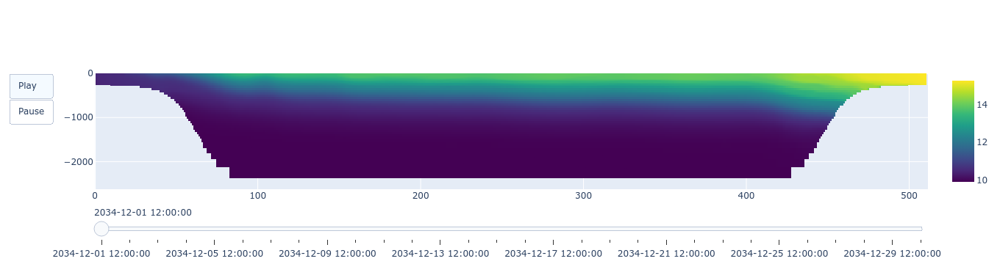

In [21]:
# Initialize figure with subplot for better control, adjust subplot params as needed
fig = make_subplots(rows=1, cols=1)

# Track all frames for the animation
frames = []

for time in t:
    # Extract data for the current time step
    current_data = T.sel(time=time).values

    # Create a heatmap for the current time step
    frame = go.Frame(
        data=[go.Heatmap(
            z=current_data,
            x=y,  # Assuming 'y' is like longitude/latitude
            y=z,  # Depth
            colorscale='Viridis')],
        name=str(time)
    )
    frames.append(frame)

# Make sure the initial state of the figure is set to the first frame
fig.add_trace(go.Heatmap(
    z=frames[0].data[0].z,
    x=y,
    y=z,
    colorscale='Viridis'
))

# Set frames to the figure
fig.frames = frames

# Add slider and play/pause buttons
fig.update_layout(
    updatemenus=[{
        'type': 'buttons',
        'buttons': [
            {'label': 'Play', 'method': 'animate', 'args': [None, {'frame': {'duration': 500, 'redraw': True}, 'fromcurrent': True}]},
            {'label': 'Pause', 'method': 'animate', 'args': [[None], {'frame': {'duration': 0, 'redraw': False}}]}
        ],
    }],
    sliders=[{
        'steps': [{'method': 'animate', 'args': [[frame.name], {'mode': 'immediate', 'frame': {'duration': 500, 'redraw': True}}], 'label': frame.name} for frame in frames],
    }]
)

# Show the figure
#fig.show()